In [1]:
import sys
import os

project_root = os.path.abspath(os.path.join('..', '..', '..'))
if project_root not in sys.path:
    sys.path.append(project_root)

In [2]:
from cyberattacks_detection.models import RBFNN, ELM, ModelWrapper, min_max_scale, reverse_min_max_scale
from sklearn.linear_model import LinearRegression
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn import metrics
import re

In [3]:
import mlflow
from mlflow.models import infer_signature

In [4]:
pd.set_option('display.max_colwidth', None)

# Przygotowanie danych

In [5]:
data_path = "../../data/four_tanks/"

In [6]:
# dane bez zakłóceń
df_train = pd.read_csv(data_path+"result_ol_without_noise_uczące_v3.csv", sep=';', index_col=0)
df_val = pd.read_csv(data_path+"result_ol_without_noise_walidacyjne_v3.csv", sep=';', index_col=0)
df_test = pd.read_csv(data_path+"result_ol_without_noise_testowe_v3.csv", sep=';', index_col=0)
dataset_name = "bez zakłóceń"

In [7]:
# # dane z zakłóceniami
# df_train = pd.read_csv(data_path+"result_ol_with_noise_uczące_v3.csv", sep=';', index_col=0)
# df_val = pd.read_csv(data_path+"result_ol_with_noise_walidacyjne_v3.csv", sep=';', index_col=0)
# df_test = pd.read_csv(data_path+"result_ol_with_noise_testowe_v3.csv", sep=';', index_col=0)
# dataset_name = "z zakłóceniami"

In [8]:
df_train.head()

,q_A [cm^3/s],q_B [cm^3/s],q_d1 [cm^3/s],q_d2 [cm^3/s],q_d3 [cm^3/s],q_d4 [cm^3/s],x1 [cm],x2 [cm],x3 [cm],x4 [cm]
0,452.78,555.56,0.0,0.0,0.0,0.0,65.000000,66.000000,65.000000,66.000000
1,452.78,555.56,0.0,0.0,-0.0,0.0,64.984326,65.937304,65.038198,65.992639
2,452.78,555.56,0.0,-0.0,0.0,-0.0,64.971213,65.878615,65.074774,65.985573
3,452.78,555.56,0.0,0.0,-0.0,-0.0,64.960438,65.823672,65.109799,65.978790
4,452.78,555.56,0.0,-0.0,0.0,-0.0,64.951795,65.772231,65.143339,65.972278


In [9]:
def transform_column_name(df):
    df.columns = [col[0] for col in df.columns.str.split()]
    return df

In [10]:
df_train = transform_column_name(df_train)
df_val = transform_column_name(df_val)
df_test = transform_column_name(df_test)

In [11]:
qa_max = round(3260000/3600, 2)
qa_min=0
qb_max = round(4000000/3600)
qb_min=0
x_max = [136,
         136,
         130,
         130]
x_min = [20,
         20,
         20,
         20]

In [12]:
def add_delay(df, col, steps=1):    
    df[col+f'(k-{steps})'] = df[col].shift(steps)
    return df

In [13]:
def add_delay_to_all_cols(df_train, df_val, df_test):
    cols_delay = ['q_A', 'q_B', 'x1', 'x2', 'x3', 'x4']
    for col in cols_delay:
        for step in range(1, 5):
            df_train = add_delay(df_train, col, step)
            df_val = add_delay(df_val, col, step)
            df_test = add_delay(df_test, col, step)
    return df_train, df_val, df_test

In [14]:
df_train, df_val, df_test = add_delay_to_all_cols(df_train, df_val, df_test)

In [15]:
df_train.dropna(inplace=True)
df_val.dropna(inplace=True)
df_test.dropna(inplace=True)

In [16]:
print(f"Wymiar danych uczących: {df_train.shape}")
print(f"Wymiar danych walidacyjnych: {df_val.shape}")
print(f"Wymiar danych testowych: {df_test.shape}")

Wymiar danych uczących: (2996, 34)
Wymiar danych walidacyjnych: (996, 34)
Wymiar danych testowych: (996, 34)


# Modelowanie

In [17]:
mlflow.set_tracking_uri("http://localhost:5000")

In [18]:
# model_class_dict = {"LR": LinearRegression, "ELM": ELM, "RBF": RBFNN}
# model_class_str = list(model_class_dict.keys())[0]

In [19]:
y_names = ['x1', 'x2', 'x3', 'x4']

In [20]:
model_type_dict = {'statespace': 'w przestrzeni stanu', 'io': 'wejście-wyjście'}

In [21]:
def normalized_x_error(RMSE, y_name):
    pattern = r'x(\d+)'
    idx = int(re.findall(pattern, y_name)[0]) - 1
    return RMSE/(x_max[idx] - x_min[idx])

In [22]:
def calc_NRMSE(df_train, df_val, df_test, y_name, y_pred_name):
    RMSE_train = metrics.root_mean_squared_error(df_train[y_name], df_train[y_pred_name])
    RMSE_val = metrics.root_mean_squared_error(df_val[y_name], df_val[y_pred_name])
    RMSE_test = metrics.root_mean_squared_error(df_test[y_name], df_test[y_pred_name])
    
    NRMSE_train = round(normalized_x_error(RMSE_train, y_name), 4)
    NRMSE_val = round(normalized_x_error(RMSE_val, y_name), 4)
    NRMSE_test = round(normalized_x_error(RMSE_test, y_name), 4)

    return NRMSE_train, NRMSE_val, NRMSE_test

In [23]:
def calc_RMSE(df_train, df_val, df_test, y_name, y_pred_name):
    RMSE_train = round(metrics.root_mean_squared_error(df_train[y_name], df_train[y_pred_name]), 4)
    RMSE_val = round(metrics.root_mean_squared_error(df_val[y_name], df_val[y_pred_name]), 4)
    RMSE_test = round(metrics.root_mean_squared_error(df_test[y_name], df_test[y_pred_name]), 4)

    return RMSE_train, RMSE_val, RMSE_test

In [24]:
def predict_recursion(df, model, features, y_name, order_dyn):
    y_pred_list = np.empty(len(df))
    start_idx = 0
    if order_dyn == 1:
        y_pred_list[0] = df[y_name].iloc[0]
        start_idx = 1
    elif order_dyn==2:
        y_pred_list[0] = df[y_name].iloc[0]
        y_pred_list[1] = df[y_name].iloc[1]
        start_idx = 2
    elif order_dyn==3:
        y_pred_list[0] = df[y_name].iloc[0]
        y_pred_list[1] = df[y_name].iloc[1]
        y_pred_list[2] = df[y_name].iloc[2]
        start_idx = 3
    elif order_dyn==4:
        y_pred_list[0] = df[y_name].iloc[0]
        y_pred_list[1] = df[y_name].iloc[1]
        y_pred_list[2] = df[y_name].iloc[2]
        y_pred_list[3] = df[y_name].iloc[3]
        start_idx = 4
    for i in range(start_idx, len(df)):
        features_val = df[features].iloc[i].copy()
        # print(f'features_val:\n{features_val}')
        if order_dyn == 1:
            features_val[f'{y_name}(k-1)'] = y_pred_list[i-1]
        if order_dyn == 2:
            features_val[f'{y_name}(k-1)'] = y_pred_list[i-1]
            features_val[f'{y_name}(k-2)'] = y_pred_list[i-2]
        if order_dyn == 3:
            features_val[f'{y_name}(k-1)'] = y_pred_list[i-1]
            features_val[f'{y_name}(k-2)'] = y_pred_list[i-2]
            features_val[f'{y_name}(k-3)'] = y_pred_list[i-3]
        if order_dyn == 4:
            features_val[f'{y_name}(k-1)'] = y_pred_list[i-1]
            features_val[f'{y_name}(k-2)'] = y_pred_list[i-2]
            features_val[f'{y_name}(k-3)'] = y_pred_list[i-3]
            features_val[f'{y_name}(k-4)'] = y_pred_list[i-4]
        # print(f'features_val:\n{features_val}')
        try:
            y_pred_list[i] = model.predict(pd.DataFrame(features_val).T).values.flatten()[0]
        except:
            y_pred_list[i] = model.predict(pd.DataFrame(features_val).T).flatten()[0]
        # print(f'y_pred: {y_pred_list[i]}')
    return y_pred_list

In [25]:
def train_predict_model(df_train,
                        df_val,
                        df_test,
                        model_class_str,
                        y_names,
                        features_list,
                        model_type,
                        order_dyn,
                        pred_mode='both',
                        features_min_list=[None, None, None, None],
                        features_max_list=[None, None, None, None],
                        **kwargs):
    # **kwargs = num_hidden_neurons=None, n_centers=None, alpha=None
    for y_name, features, features_min, features_max in zip(y_names,
                                                            features_list,
                                                            features_min_list,
                                                            features_max_list):
        
        print(y_name)

        mlflow.set_experiment(f"four_tanks_{y_name.replace('x', 'h')}_v2")

        if model_class_str == 'LR':
            model = LinearRegression()
            model.fit(df_train[features], df_train[[y_name]])

        elif model_class_str == 'ELM':
            num_features = len(features)
            num_hidden_neurons = kwargs["num_hidden_neurons"]
            model = ELM(num_features, num_hidden_neurons)
            pattern = r'x(\d+)'
            idx = int(re.findall(pattern, y_name)[0]) - 1
            model.fit(df_train[features],
                      df_train[[y_name]],
                      features_min,
                      features_max,
                      x_min[idx],
                      x_max[idx])
            
        elif model_class_str == 'RBF':
            n_centers = kwargs["n_centers"]
            alpha = kwargs["alpha"]
            model = RBFNN(n_centers, alpha)
            pattern = r'x(\d+)'
            idx = int(re.findall(pattern, y_name)[0]) - 1
            iterations = kwargs["iterations"]
            patience = kwargs["patience"]
            it = model.fit(df_train[features],
                      df_train[[y_name]],
                      features_min,
                      features_max,
                      x_min[idx],
                      x_max[idx],
                      iterations=iterations,
                      X_val=df_val[features],
                      y_val=df_val[[y_name]],
                      patience=patience,
                      metric=metrics.mean_squared_error)
            if it is not None:
                kwargs["iterations_real"] = it
            else:
                kwargs["iterations_real"] = kwargs["iterations"]

        params = {"model_class": model_class_str,
                  "model_type": model_type_dict[model_type],
                  "order_dyn": order_dyn,
                  "y_name": y_name+'(k)',
                  "features": features} | kwargs
        
        pred_mode_tuple = ("both", "not_recursion", "recursion")
        # TODO: sprawdzić jak zadziała w przypadku błędnej wartości
        metrics_not_rec = {}
        metrics_rec = {}
        if pred_mode not in pred_mode_tuple:
            raise ValueError(f"Bad value for recursion_mode agument. Possible values: {pred_mode_tuple}")
        if pred_mode in ("both", "not_recursion"):
            df_train[f'{y_name}_{model_type}_{order_dyn}_pred'] = model.predict(df_train[features])
            df_val[f'{y_name}_{model_type}_{order_dyn}_pred'] = model.predict(df_val[features])
            df_test[f'{y_name}_{model_type}_{order_dyn}_pred'] = model.predict(df_test[features])
            RMSE_train, RMSE_val, RMSE_test = calc_RMSE(df_train,
                                                        df_val,
                                                        df_test,
                                                        y_name,
                                                        f'{y_name}_{model_type}_{order_dyn}_pred')
            metrics_not_rec = {"RMSE_train": RMSE_train, "RMSE_val": RMSE_val, "RMSE_test": RMSE_test}
            NRMSE_train, NRMSE_val, NRMSE_test = calc_NRMSE(df_train,
                                                            df_val,
                                                            df_test,
                                                            y_name,
                                                            f'{y_name}_{model_type}_{order_dyn}_pred')
            metrics_norm_not_rec = {"NRMSE_train": NRMSE_train,
                                    "NRMSE_val": NRMSE_val,
                                    "NRMSE_test": NRMSE_test}
        if pred_mode in ("both", "recursion"):
            df_train[f'{y_name}_{model_type}_{order_dyn}_recursion_pred'] = predict_recursion(df_train, model, features, y_name, order_dyn)
            df_val[f'{y_name}_{model_type}_{order_dyn}_recursion_pred'] = predict_recursion(df_val, model, features, y_name, order_dyn)
            df_test[f'{y_name}_{model_type}_{order_dyn}_recursion_pred'] = predict_recursion(df_test, model, features, y_name, order_dyn)
            RMSE_train, RMSE_val, RMSE_test = calc_RMSE(df_train, df_val, df_test, y_name, f'{y_name}_{model_type}_{order_dyn}_recursion_pred')
            metrics_rec = {"RMSE_train_recursion": RMSE_train, "RMSE_val_recursion": RMSE_val, "RMSE_test_recursion": RMSE_test}
            NRMSE_train, NRMSE_val, NRMSE_test = calc_NRMSE(df_train,
                                                            df_val,
                                                            df_test,
                                                            y_name,
                                                            f'{y_name}_{model_type}_{order_dyn}_recursion_pred')
            metrics_norm_rec = {"NRMSE_train_recursion": NRMSE_train,
                                "NRMSE_val_recursion": NRMSE_val,
                                "NRMSE_test_recursion": NRMSE_test}

        metrics_list = metrics_not_rec | metrics_norm_not_rec | metrics_rec | metrics_norm_rec
        
        with mlflow.start_run():
            mlflow.log_params(params)
            mlflow.log_metrics(metrics_list)

            # Infer the model signature
            signature = infer_signature(df_train[features], df_train[f'{y_name}_{model_type}_{order_dyn}_pred'])
            # Log the model
            if model_class_str == 'LR':
                model_info = mlflow.sklearn.log_model(
                sk_model=model,
                artifact_path=model_class_str,
                signature=signature,
                input_example=df_train[features],
                registered_model_name=f"{model_class_str}_{model_type}_{order_dyn}_{y_name}",
            )
            else:
                model_info = mlflow.pyfunc.log_model(
                    python_model=ModelWrapper(model),
                    artifact_path=model_class_str,
                    signature=signature,
                    input_example=df_train[features],
                    registered_model_name=f"{model_class_str}_{model_type}_{order_dyn}_{y_name}",
                )

    return df_train, df_val, df_test

In [26]:
pred_mode = "both"
model_class_list = ["LR", "ELM", "RBF"]

In [27]:
xxxx

NameError: name 'xxxx' is not defined

## LinearRegression

In [28]:
model_class_str = model_class_list[0]
print(model_class_str)

LR


In [ ]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'x3(k-1)', 'x4(k-1)', 'x1(k-1)'],
                 ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'x3(k-1)', 'x4(k-1)', 'x2(k-1)'],
                 ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'x2(k-1)', 'x4(k-1)', 'x3(k-1)'],
                 ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'x2(k-1)', 'x3(k-1)', 'x4(k-1)']]
model_type = 'statespace'
order_dyn = 1
df_train, df_val, df_test = train_predict_model(df_train, df_val, df_test, model_class_str, y_names, features_list, model_type, order_dyn, pred_mode)

[[65.05028601]]
<class 'numpy.ndarray'>
65.05028600934114
<class 'numpy.float64'>
[[65.14595441]]
<class 'numpy.ndarray'>
65.14595440522142
<class 'numpy.float64'>
[[65.23887761]]
<class 'numpy.ndarray'>
65.23887761162025
<class 'numpy.float64'>
[[65.32913062]]
<class 'numpy.ndarray'>
65.32913061787632
<class 'numpy.float64'>
[[65.41678649]]
<class 'numpy.ndarray'>
65.41678649321135
<class 'numpy.float64'>
[[65.50191643]]
<class 'numpy.ndarray'>
65.50191643299318
<class 'numpy.float64'>
[[65.5845898]]
<class 'numpy.ndarray'>
65.58458980381529
<class 'numpy.float64'>
[[65.66487419]]
<class 'numpy.ndarray'>
65.6648741874384
<class 'numpy.float64'>
[[65.74283542]]
<class 'numpy.ndarray'>
65.74283542363702
<class 'numpy.float64'>
[[65.81853765]]
<class 'numpy.ndarray'>
65.81853765199143
<class 'numpy.float64'>
[[65.89204335]]
<class 'numpy.ndarray'>
65.89204335266305
<class 'numpy.float64'>
[[65.96341339]]
<class 'numpy.ndarray'>
65.96341338618873
<class 'numpy.float64'>
[[66.03270703]]
<c

Registered model 'LR_statespace_1_x1' already exists. Creating a new version of this model...
2024/12/15 16:12:32 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: LR_statespace_1_x1, version 14
Created version '14' of model 'LR_statespace_1_x1'.
c:\Users\zgore\anaconda3\envs\cyber-attk\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
2024/12/15 16:12:37 INFO mlflow.tracking._tracking_service.client: 🏃 View run beautiful-wasp-504 at: http://localhost:5000/#/experiments/337985756877122343/runs/40fd937e12c944f7a8f73bfdac4fb211.
2024/12/15 16:12:37 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://localhost:5000/#/experiments/337985756877122343.


[[65.74882487]]
<class 'numpy.ndarray'>
65.74882487441089
<class 'numpy.float64'>
[[65.72644588]]
<class 'numpy.ndarray'>
65.72644587504436
<class 'numpy.float64'>
[[65.70504282]]
<class 'numpy.ndarray'>
65.7050428217028
<class 'numpy.float64'>
[[65.68456724]]
<class 'numpy.ndarray'>
65.68456723654013
<class 'numpy.float64'>
[[65.66497338]]
<class 'numpy.ndarray'>
65.66497337822307
<class 'numpy.float64'>
[[65.64621807]]
<class 'numpy.ndarray'>
65.64621807302841
<class 'numpy.float64'>
[[65.62826056]]
<class 'numpy.ndarray'>
65.62826055683722
<class 'numpy.float64'>
[[65.61106233]]
<class 'numpy.ndarray'>
65.61106232731557
<class 'numpy.float64'>
[[65.59458701]]
<class 'numpy.ndarray'>
65.59458700561655
<class 'numpy.float64'>
[[65.57880021]]
<class 'numpy.ndarray'>
65.57880020698146
<class 'numpy.float64'>
[[65.56366942]]
<class 'numpy.ndarray'>
65.56366941965842
<class 'numpy.float64'>
[[65.54916389]]
<class 'numpy.ndarray'>
65.54916389159423
<class 'numpy.float64'>
[[65.53525452]]
<

KeyboardInterrupt: 

In [57]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)']]
model_type = 'io'
order_dyn = 1
df_train, df_val, df_test = train_predict_model(df_train, df_val, df_test, model_class_str, y_names, features_list, model_type, order_dyn, pred_mode)

C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:43: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:43: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:43: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pre

In [58]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x1(k-2)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x2(k-2)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x3(k-2)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x4(k-2)']]
model_type = 'io'
order_dyn = 2
df_train, df_val, df_test = train_predict_model(df_train, df_val, df_test, model_class_str, y_names, features_list, model_type, order_dyn, pred_mode)

C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:43: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:43: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:43: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pre

In [59]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x1(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x1(k-3)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x2(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x2(k-3)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x3(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x3(k-3)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x4(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x4(k-3)']]
model_type = 'io'
order_dyn = 3
df_train, df_val, df_test = train_predict_model(df_train, df_val, df_test, model_class_str, y_names, features_list, model_type, order_dyn, pred_mode)

C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:43: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:43: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T)
C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:43: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pre

ValueError: setting an array element with a sequence.

In [ ]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x1(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x1(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x1(k-4)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x2(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x2(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x2(k-4)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x3(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x3(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x3(k-4)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x4(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x4(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x4(k-4)']]
model_type = 'io'
order_dyn = 4
df_train, df_val, df_test = train_predict_model(df_train, df_val, df_test, model_class_str, y_names, features_list, model_type, order_dyn, pred_mode)

## Extreme Learning Machine

In [31]:
model_class_str = model_class_list[1]
print(model_class_str)

ELM


In [32]:
num_hidden_neurons = 30

In [37]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'x3(k-1)', 'x4(k-1)', 'x1(k-1)'],
                 ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'x3(k-1)', 'x4(k-1)', 'x2(k-1)'],
                 ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'x2(k-1)', 'x4(k-1)', 'x3(k-1)'],
                 ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'x2(k-1)', 'x3(k-1)', 'x4(k-1)']]
features_min_list = np.array([[qa_min, qb_min, x_min[1], x_min[2], x_min[3], x_min[0]],
                     [qa_min, qb_min, x_min[0], x_min[2], x_min[3], x_min[1]],
                     [qa_min, qb_min, x_min[0], x_min[1], x_min[3], x_min[2]],
                     [qa_min, qb_min, x_min[0], x_min[1], x_min[2], x_min[3]]])
features_max_list = np.array([[qa_max, qb_max, x_max[1], x_max[2], x_max[3], x_max[0]],
                     [qa_max, qb_max, x_max[0], x_max[2], x_max[3], x_max[1]],
                     [qa_max, qb_max, x_max[0], x_max[1], x_max[3], x_max[2]],
                     [qa_max, qb_max, x_max[0], x_max[1], x_max[2], x_max[3]]])
model_type = 'statespace'
order_dyn = 1
df_train, df_val, df_test = train_predict_model(df_train,
                                                df_val,
                                                df_test,
                                                model_class_str,
                                                y_names,
                                                features_list,
                                                model_type,
                                                order_dyn,
                                                pred_mode,
                                                features_min_list=features_min_list,
                                                features_max_list=features_max_list,
                                                num_hidden_neurons = num_hidden_neurons)

64.96856869639561
<class 'numpy.float64'>
64.98610243091488
<class 'numpy.float64'>
65.00425560633096
<class 'numpy.float64'>
65.02290126349051
<class 'numpy.float64'>
65.04192532454675
<class 'numpy.float64'>
65.06122547265932
<class 'numpy.float64'>
65.08071012602645
<class 'numpy.float64'>
65.10029749798863
<class 'numpy.float64'>
65.11991473573791
<class 'numpy.float64'>
65.13949713087877
<class 'numpy.float64'>
65.15898739572036
<class 'numpy.float64'>
65.17833499974446
<class 'numpy.float64'>
65.19749556120237
<class 'numpy.float64'>
65.21643028924493
<class 'numpy.float64'>
65.23510547240227
<class 'numpy.float64'>
65.25349200959441
<class 'numpy.float64'>
65.27156498018533
<class 'numpy.float64'>
65.2893032498956
<class 'numpy.float64'>
65.30668910965554
<class 'numpy.float64'>
65.32370794473007
<class 'numpy.float64'>
65.34034793166616
<class 'numpy.float64'>
65.35659976081942
<class 'numpy.float64'>
65.37245638239797
<class 'numpy.float64'>
65.38791277413233
<class 'numpy.flo

AttributeError: 'DataFrame' object has no attribute 'flatten'

In [ ]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)']]
features_min_list = np.array([[qa_min, qb_min, x_min[0]],
                     [qa_min, qb_min, x_min[1]],
                     [qa_min, qb_min, x_min[2]],
                     [qa_min, qb_min, x_min[3]]])
features_max_list = np.array([[qa_max, qb_max, x_max[0]],
                     [qa_max, qb_max, x_max[1]],
                     [qa_max, qb_max, x_max[2]],
                     [qa_max, qb_max, x_max[3]]])
model_type = 'io'
order_dyn = 1
df_train, df_val, df_test = train_predict_model(df_train,
                                                df_val,
                                                df_test,
                                                model_class_str,
                                                y_names,
                                                features_list,
                                                model_type,
                                                order_dyn,
                                                pred_mode,
                                                features_min_list=features_min_list,
                                                features_max_list=features_max_list,
                                                num_hidden_neurons = num_hidden_neurons)

C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T).values
C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T).values
C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 

In [ ]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x1(k-2)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x2(k-2)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x3(k-2)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x4(k-2)']]
features_min_list = np.array([[qa_min, qb_min, x_min[0], qa_min, qb_min, x_min[0]],
                     [qa_min, qb_min, x_min[1], qa_min, qb_min, x_min[1]],
                     [qa_min, qb_min, x_min[2], qa_min, qb_min, x_min[2]],
                     [qa_min, qb_min, x_min[3], qa_min, qb_min, x_min[3]]])
features_max_list = np.array([[qa_max, qb_max, x_max[0], qa_max, qb_max, x_max[0]],
                     [qa_max, qb_max, x_max[1], qa_max, qb_max, x_max[1]],
                     [qa_max, qb_max, x_max[2], qa_max, qb_max, x_max[2]],
                     [qa_max, qb_max, x_max[3], qa_max, qb_max, x_max[3]]])
model_type = 'io'
order_dyn = 2
df_train, df_val, df_test = train_predict_model(df_train,
                                                df_val,
                                                df_test,
                                                model_class_str,
                                                y_names,
                                                features_list,
                                                model_type,
                                                order_dyn,
                                                pred_mode,
                                                features_min_list=features_min_list,
                                                features_max_list=features_max_list,
                                                num_hidden_neurons = num_hidden_neurons)

C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T).values
C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T).values
C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 

In [ ]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x1(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x1(k-3)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x2(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x2(k-3)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x3(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x3(k-3)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x4(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x4(k-3)']]
features_min_list = np.array([[qa_min, qb_min, x_min[0], qa_min, qb_min, x_min[0], qa_min, qb_min, x_min[0]],
                     [qa_min, qb_min, x_min[1], qa_min, qb_min, x_min[1], qa_min, qb_min, x_min[1]],
                     [qa_min, qb_min, x_min[2], qa_min, qb_min, x_min[2], qa_min, qb_min, x_min[2]],
                     [qa_min, qb_min, x_min[3], qa_min, qb_min, x_min[3], qa_min, qb_min, x_min[3]]])
features_max_list = np.array([[qa_max, qb_max, x_max[0], qa_max, qb_max, x_max[0], qa_max, qb_max, x_max[0]],
                     [qa_max, qb_max, x_max[1], qa_max, qb_max, x_max[1], qa_max, qb_max, x_max[1]],
                     [qa_max, qb_max, x_max[2], qa_max, qb_max, x_max[2], qa_max, qb_max, x_max[2]],
                     [qa_max, qb_max, x_max[3], qa_max, qb_max, x_max[3], qa_max, qb_max, x_max[3]]])
model_type = 'io'
order_dyn = 3
df_train, df_val, df_test = train_predict_model(df_train,
                                                df_val,
                                                df_test,
                                                model_class_str,
                                                y_names,
                                                features_list,
                                                model_type,
                                                order_dyn,
                                                pred_mode,
                                                features_min_list=features_min_list,
                                                features_max_list=features_max_list,
                                                num_hidden_neurons = num_hidden_neurons)

C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T).values
C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T).values
C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 

C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T).values
C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  y_pred_list[i] = model.predict(pd.DataFrame(features_val).T).values
C:\Users\zgore\AppData\Local\Temp\ipykernel_14348\1219150148.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 

In [41]:
# features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x1(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x1(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x1(k-4)'],
#  ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x2(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x2(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x2(k-4)'],
#  ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x3(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x3(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x3(k-4)'],
#  ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x4(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x4(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x4(k-4)']]
# model_type = 'io'
# order_dyn = 4
# df_train, df_val, df_test = train_predict_model(df_train, df_val, df_test, model_class_str, y_names, features_list, model_type, order_dyn, pred_mode, num_hidden_neurons = num_hidden_neurons)

## Radial Base Function Neural Network

In [28]:
model_class_str = model_class_list[2]
print(model_class_str)

RBF


In [29]:
n_centers = 30
alpha = 0.001

In [31]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'x3(k-1)', 'x4(k-1)', 'x1(k-1)'],
                 ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'x3(k-1)', 'x4(k-1)', 'x2(k-1)'],
                 ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'x2(k-1)', 'x4(k-1)', 'x3(k-1)'],
                 ['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'x2(k-1)', 'x3(k-1)', 'x4(k-1)']]
features_min_list = np.array([[qa_min, qb_min, x_min[1], x_min[2], x_min[3], x_min[0]],
                     [qa_min, qb_min, x_min[0], x_min[2], x_min[3], x_min[1]],
                     [qa_min, qb_min, x_min[0], x_min[1], x_min[3], x_min[2]],
                     [qa_min, qb_min, x_min[0], x_min[1], x_min[2], x_min[3]]])
features_max_list = np.array([[qa_max, qb_max, x_max[1], x_max[2], x_max[3], x_max[0]],
                     [qa_max, qb_max, x_max[0], x_max[2], x_max[3], x_max[1]],
                     [qa_max, qb_max, x_max[0], x_max[1], x_max[3], x_max[2]],
                     [qa_max, qb_max, x_max[0], x_max[1], x_max[2], x_max[3]]])
model_type = 'statespace'
order_dyn = 1
df_train, df_val, df_test = train_predict_model(df_train,
                                                df_val,
                                                df_test,
                                                model_class_str,
                                                y_names,
                                                features_list,
                                                model_type,
                                                order_dyn,
                                                pred_mode,
                                                features_min_list=features_min_list,
                                                features_max_list=features_max_list,
                                                n_centers=n_centers,
                                                alpha=alpha,
                                                iterations=300,
                                                patience=100)

x1
Early stopping at epoch 125. Best metric: 3510.3412252483677


Registered model 'RBF_statespace_1_x1' already exists. Creating a new version of this model...
2024/12/15 17:44:23 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: RBF_statespace_1_x1, version 28
Created version '28' of model 'RBF_statespace_1_x1'.
c:\Users\zgore\anaconda3\envs\cyber-attk\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
2024/12/15 17:44:29 INFO mlflow.tracking._tracking_service.client: 🏃 View run powerful-flea-377 at: http://localhost:5000/#/experiments/337985756877122343/runs/43f8d748e3444e80a2771897533fdff1.
2024/12/15 17:44:29 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://localhost:5000/#/experiments/337985756877122343.


x2
Early stopping at epoch 101. Best metric: 4613.152976716925


Registered model 'RBF_statespace_1_x2' already exists. Creating a new version of this model...
2024/12/15 17:50:35 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: RBF_statespace_1_x2, version 28
Created version '28' of model 'RBF_statespace_1_x2'.
2024/12/15 17:50:41 INFO mlflow.tracking._tracking_service.client: 🏃 View run aged-mule-962 at: http://localhost:5000/#/experiments/762266801528390388/runs/bad7ef9e9cb4453abd8c4a4e9ff624e0.
2024/12/15 17:50:41 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://localhost:5000/#/experiments/762266801528390388.


x3


Registered model 'RBF_statespace_1_x3' already exists. Creating a new version of this model...
2024/12/15 18:08:39 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: RBF_statespace_1_x3, version 23
Created version '23' of model 'RBF_statespace_1_x3'.
2024/12/15 18:08:45 INFO mlflow.tracking._tracking_service.client: 🏃 View run indecisive-cow-400 at: http://localhost:5000/#/experiments/113533329770808730/runs/9405923f128a4b7288da70cd08dd0e2c.
2024/12/15 18:08:45 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://localhost:5000/#/experiments/113533329770808730.


x4
Early stopping at epoch 101. Best metric: 25826.370083952843


Registered model 'RBF_statespace_1_x4' already exists. Creating a new version of this model...
2024/12/15 18:14:52 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: RBF_statespace_1_x4, version 22
Created version '22' of model 'RBF_statespace_1_x4'.
2024/12/15 18:14:57 INFO mlflow.tracking._tracking_service.client: 🏃 View run spiffy-calf-434 at: http://localhost:5000/#/experiments/996782970443829195/runs/1966dd8d49c24e1bb4bbc61a66d314d0.
2024/12/15 18:14:57 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://localhost:5000/#/experiments/996782970443829195.


In [34]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)']]
features_min_list = np.array([[qa_min, qb_min, x_min[0]],
                     [qa_min, qb_min, x_min[1]],
                     [qa_min, qb_min, x_min[2]],
                     [qa_min, qb_min, x_min[3]]])
features_max_list = np.array([[qa_max, qb_max, x_max[0]],
                     [qa_max, qb_max, x_max[1]],
                     [qa_max, qb_max, x_max[2]],
                     [qa_max, qb_max, x_max[3]]])
model_type = 'io'
order_dyn = 1
df_train, df_val, df_test = train_predict_model(df_train,
                                                df_val,
                                                df_test,
                                                model_class_str,
                                                y_names,
                                                features_list,
                                                model_type,
                                                order_dyn,
                                                pred_mode,
                                                features_min_list=features_min_list,
                                                features_max_list=features_max_list,
                                                n_centers=n_centers,
                                                alpha=alpha,
                                                iterations=300,
                                                patience=100)

x1
Early stopping at epoch 144. Best metric: 0.09523785210346808


Registered model 'RBF_io_1_x1' already exists. Creating a new version of this model...
2024/12/15 18:58:21 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: RBF_io_1_x1, version 18
Created version '18' of model 'RBF_io_1_x1'.
2024/12/15 18:58:26 INFO mlflow.tracking._tracking_service.client: 🏃 View run capable-mare-248 at: http://localhost:5000/#/experiments/337985756877122343/runs/a4d4c195d0894ffaada40229041a364a.
2024/12/15 18:58:26 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://localhost:5000/#/experiments/337985756877122343.


x2
Early stopping at epoch 126. Best metric: 866.3168509920987


Registered model 'RBF_io_1_x2' already exists. Creating a new version of this model...
2024/12/15 19:06:13 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: RBF_io_1_x2, version 18
Created version '18' of model 'RBF_io_1_x2'.
2024/12/15 19:06:19 INFO mlflow.tracking._tracking_service.client: 🏃 View run bedecked-wasp-780 at: http://localhost:5000/#/experiments/762266801528390388/runs/99f743ccbeb24c0380f0a335cb688d09.
2024/12/15 19:06:19 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://localhost:5000/#/experiments/762266801528390388.


x3
Early stopping at epoch 101. Best metric: 17364.694967840358


Registered model 'RBF_io_1_x3' already exists. Creating a new version of this model...
2024/12/15 19:12:36 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: RBF_io_1_x3, version 18
Created version '18' of model 'RBF_io_1_x3'.
2024/12/15 19:12:42 INFO mlflow.tracking._tracking_service.client: 🏃 View run sedate-shrew-206 at: http://localhost:5000/#/experiments/113533329770808730/runs/9ad4a7087e504cb2b054f273ea0fcd69.
2024/12/15 19:12:42 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://localhost:5000/#/experiments/113533329770808730.


x4
Early stopping at epoch 101. Best metric: 12708.538923884555


Registered model 'RBF_io_1_x4' already exists. Creating a new version of this model...
2024/12/15 19:19:01 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: RBF_io_1_x4, version 18
Created version '18' of model 'RBF_io_1_x4'.
2024/12/15 19:19:06 INFO mlflow.tracking._tracking_service.client: 🏃 View run resilient-ray-373 at: http://localhost:5000/#/experiments/996782970443829195/runs/fd808b8e7cad4430947f3a7524423118.
2024/12/15 19:19:06 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://localhost:5000/#/experiments/996782970443829195.


In [35]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x1(k-2)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x2(k-2)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x3(k-2)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x4(k-2)']]
features_min_list = np.array([[qa_min, qb_min, x_min[0], qa_min, qb_min, x_min[0]],
                     [qa_min, qb_min, x_min[1], qa_min, qb_min, x_min[1]],
                     [qa_min, qb_min, x_min[2], qa_min, qb_min, x_min[2]],
                     [qa_min, qb_min, x_min[3], qa_min, qb_min, x_min[3]]])
features_max_list = np.array([[qa_max, qb_max, x_max[0], qa_max, qb_max, x_max[0]],
                     [qa_max, qb_max, x_max[1], qa_max, qb_max, x_max[1]],
                     [qa_max, qb_max, x_max[2], qa_max, qb_max, x_max[2]],
                     [qa_max, qb_max, x_max[3], qa_max, qb_max, x_max[3]]])
model_type = 'io'
order_dyn = 2
df_train, df_val, df_test = train_predict_model(df_train,
                                                df_val,
                                                df_test,
                                                model_class_str,
                                                y_names,
                                                features_list,
                                                model_type,
                                                order_dyn,
                                                pred_mode,
                                                features_min_list=features_min_list,
                                                features_max_list=features_max_list,
                                                n_centers=n_centers,
                                                alpha=alpha,
                                                iterations=300,
                                                patience=100)

x1


Registered model 'RBF_io_2_x1' already exists. Creating a new version of this model...
2024/12/15 19:37:14 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: RBF_io_2_x1, version 18
Created version '18' of model 'RBF_io_2_x1'.
2024/12/15 19:37:20 INFO mlflow.tracking._tracking_service.client: 🏃 View run persistent-fowl-703 at: http://localhost:5000/#/experiments/337985756877122343/runs/1f174b0addbb4aeea0b95604ec669196.
2024/12/15 19:37:20 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://localhost:5000/#/experiments/337985756877122343.


x2
Early stopping at epoch 195. Best metric: 1346.4793410867583


Registered model 'RBF_io_2_x2' already exists. Creating a new version of this model...
2024/12/15 19:49:03 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: RBF_io_2_x2, version 18
Created version '18' of model 'RBF_io_2_x2'.
2024/12/15 19:49:09 INFO mlflow.tracking._tracking_service.client: 🏃 View run grandiose-bird-965 at: http://localhost:5000/#/experiments/762266801528390388/runs/550f367b07e34231bd01559fd647fe2c.
2024/12/15 19:49:09 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://localhost:5000/#/experiments/762266801528390388.


x3
Early stopping at epoch 101. Best metric: 36475.08458481228


Registered model 'RBF_io_2_x3' already exists. Creating a new version of this model...
2024/12/15 19:55:16 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: RBF_io_2_x3, version 16
Created version '16' of model 'RBF_io_2_x3'.
2024/12/15 19:55:21 INFO mlflow.tracking._tracking_service.client: 🏃 View run rumbling-toad-95 at: http://localhost:5000/#/experiments/113533329770808730/runs/337052aa74e644dc9b321d857cc592f8.
2024/12/15 19:55:21 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://localhost:5000/#/experiments/113533329770808730.


x4


Registered model 'RBF_io_2_x4' already exists. Creating a new version of this model...
2024/12/15 20:13:06 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: RBF_io_2_x4, version 16
Created version '16' of model 'RBF_io_2_x4'.
2024/12/15 20:13:11 INFO mlflow.tracking._tracking_service.client: 🏃 View run orderly-fly-359 at: http://localhost:5000/#/experiments/996782970443829195/runs/fc0d97f389e943018205c1e95bbe391e.
2024/12/15 20:13:11 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://localhost:5000/#/experiments/996782970443829195.


In [ ]:
features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x1(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x1(k-3)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x2(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x2(k-3)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x3(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x3(k-3)'],
 ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x4(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x4(k-3)']]
features_min_list = np.array([[qa_min, qb_min, x_min[0], qa_min, qb_min, x_min[0], qa_min, qb_min, x_min[0]],
                     [qa_min, qb_min, x_min[1], qa_min, qb_min, x_min[1], qa_min, qb_min, x_min[1]],
                     [qa_min, qb_min, x_min[2], qa_min, qb_min, x_min[2], qa_min, qb_min, x_min[2]],
                     [qa_min, qb_min, x_min[3], qa_min, qb_min, x_min[3], qa_min, qb_min, x_min[3]]])
features_max_list = np.array([[qa_max, qb_max, x_max[0], qa_max, qb_max, x_max[0], qa_max, qb_max, x_max[0]],
                     [qa_max, qb_max, x_max[1], qa_max, qb_max, x_max[1], qa_max, qb_max, x_max[1]],
                     [qa_max, qb_max, x_max[2], qa_max, qb_max, x_max[2], qa_max, qb_max, x_max[2]],
                     [qa_max, qb_max, x_max[3], qa_max, qb_max, x_max[3], qa_max, qb_max, x_max[3]]])
model_type = 'io'
order_dyn = 3
df_train, df_val, df_test = train_predict_model(df_train,
                                                df_val,
                                                df_test,
                                                model_class_str,
                                                y_names,
                                                features_list,
                                                model_type,
                                                order_dyn,
                                                pred_mode,
                                                features_min_list=features_min_list,
                                                features_max_list=features_max_list,
                                                n_centers=n_centers,
                                                alpha=alpha,
                                                iterations=300,
                                                patience=100)

x1


Registered model 'RBF_io_3_x1' already exists. Creating a new version of this model...
2024/12/15 20:31:23 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: RBF_io_3_x1, version 16
Created version '16' of model 'RBF_io_3_x1'.
2024/12/15 20:31:29 INFO mlflow.tracking._tracking_service.client: 🏃 View run mercurial-rook-749 at: http://localhost:5000/#/experiments/337985756877122343/runs/b66ae091a6c84aa19bcadbea755f6683.
2024/12/15 20:31:29 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://localhost:5000/#/experiments/337985756877122343.


x2
Early stopping at epoch 213. Best metric: 0.008489223991334782


Registered model 'RBF_io_3_x2' already exists. Creating a new version of this model...
2024/12/15 20:44:31 INFO mlflow.store.model_registry.abstract_store: Waiting up to 300 seconds for model version to finish creation. Model name: RBF_io_3_x2, version 16
Created version '16' of model 'RBF_io_3_x2'.
2024/12/15 20:44:37 INFO mlflow.tracking._tracking_service.client: 🏃 View run secretive-cat-409 at: http://localhost:5000/#/experiments/762266801528390388/runs/5c4091b6099b494f86627bf19ef73bb0.
2024/12/15 20:44:37 INFO mlflow.tracking._tracking_service.client: 🧪 View experiment at: http://localhost:5000/#/experiments/762266801528390388.


x3


In [48]:
# features_list = [['q_A(k-1)', 'q_B(k-1)', 'x1(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x1(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x1(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x1(k-4)'],
#  ['q_A(k-1)', 'q_B(k-1)', 'x2(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x2(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x2(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x2(k-4)'],
#  ['q_A(k-1)', 'q_B(k-1)', 'x3(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x3(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x3(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x3(k-4)'],
#  ['q_A(k-1)', 'q_B(k-1)', 'x4(k-1)', 'q_A(k-2)', 'q_B(k-2)', 'x4(k-2)', 'q_A(k-3)', 'q_B(k-3)', 'x4(k-3)', 'q_A(k-4)', 'q_B(k-4)', 'x4(k-4)']]
# model_type = 'io'
# order_dyn = 4
# df_train, df_val, df_test = train_predict_model(df_train, df_val, df_test, model_class_str, y_names, features_list, model_type, order_dyn, pred_mode, n_centers=n_centers, alpha=alpha)

In [49]:
def plot_model_result(df, y_name, y_pred_list):
    plt.grid()
    plt.plot(df[y_name], label=f'dane rzeczywiste')
    colors = ['tab:orange', 'tab:green', 'tab:purple', 'tab:red', 'tab:cyan', 'tab:gray']
    color_i=0
    line_styles = ['--', '-.', (0, (5, 5)), (0, (3, 5, 1, 5)), ':']
    for i, y_name_pred in enumerate(y_pred_list):
        plt.plot(y_name_pred, label=f'wyjście modelu {i+1}', linestyle=line_styles[i % len(line_styles)], c=colors[i%len(colors)])
    plt.xlabel('k')
    plt.ylabel(f'$x_{y_name[1]} [cm]$')
    plt.title(f"Poziom cieczy w {y_name[1]}. zbiorniku")
    plt.legend()

In [50]:
def plot_model_result_all_tanks(df, dataset_name, data_name, pred_mode, y_pred_dict):
    num_plots = 4
    # if pred_mode=='z rekurencją':
    #     num_plots=5
    fig=plt.figure(figsize=(8,11.5))
    plt.subplot(num_plots, 1, 1)
    plot_model_result(df, 'x1', [y_pred_dict['x1']])
    plt.subplot(num_plots, 1, 2)
    plot_model_result(df, 'x2', [y_pred_dict['x2']])
    plt.subplot(num_plots, 1, 3)
    plot_model_result(df, 'x3', [y_pred_dict['x3']])
    # if pred_mode=='z rekurencją':
    #     plt.subplot(num_plots, 1, 4)
    #     df_to_plot = df.drop(columns=['x3_statespace_1_pred'])
    #     plot_model_result_without_h1(df_to_plot, 'x3')
    plt.subplot(num_plots, 1, num_plots)
    plot_model_result(df, 'x4', [y_pred_dict['x4']])

    plt.subplots_adjust(hspace=0.4*num_plots/4)
    fig.subplots_adjust(top=0.92)
    fig.suptitle(f"Wyniki {pred_mode} modeli liniowych dla danych {data_name} {dataset_name}")

    plt.savefig(f"../../plots/result_ol_{model_class_str}_{data_name}_{dataset_name}_{pred_mode}.png", bbox_inches='tight')

    plt.show()

In [51]:
pred_mode = "bez rekurencji"

In [52]:
# x1
logged_model = 'runs:/6d4684620fc544f6b6f1b1479b60c6c2/ELM'
# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)
loaded_model_unwrap = loaded_model.unwrap_python_model().model
x1_pred_train = loaded_model.predict(pd.DataFrame(df_train[loaded_model_unwrap.feature_names_in_]))
x1_pred_test = loaded_model.predict(pd.DataFrame(df_test[loaded_model_unwrap.feature_names_in_]))
x1_pred_val = loaded_model.predict(pd.DataFrame(df_val[loaded_model_unwrap.feature_names_in_]))

# x2
logged_model = 'runs:/5d409109925749a7bb42d7d451357f50/ELM'
# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)
loaded_model_unwrap = loaded_model.unwrap_python_model().model
x2_pred_train = loaded_model.predict(pd.DataFrame(df_train[loaded_model_unwrap.feature_names_in_]))
x2_pred_test = loaded_model.predict(pd.DataFrame(df_test[loaded_model_unwrap.feature_names_in_]))
x2_pred_val = loaded_model.predict(pd.DataFrame(df_val[loaded_model_unwrap.feature_names_in_]))

# x3
logged_model = 'runs:/02f8e67e11094272a3625e4afddd2859/ELM'
# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)
loaded_model_unwrap = loaded_model.unwrap_python_model().model
x3_pred_train = loaded_model.predict(pd.DataFrame(df_train[loaded_model_unwrap.feature_names_in_]))
x3_pred_test = loaded_model.predict(pd.DataFrame(df_test[loaded_model_unwrap.feature_names_in_]))
x3_pred_val = loaded_model.predict(pd.DataFrame(df_val[loaded_model_unwrap.feature_names_in_]))

# x4
logged_model = 'runs:/57edc788bfa84efd80f1810e47f9e7ac/ELM'
# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)
loaded_model_unwrap = loaded_model.unwrap_python_model().model
x4_pred_train = loaded_model.predict(pd.DataFrame(df_train[loaded_model_unwrap.feature_names_in_]))
x4_pred_test = loaded_model.predict(pd.DataFrame(df_test[loaded_model_unwrap.feature_names_in_]))
x4_pred_val = loaded_model.predict(pd.DataFrame(df_val[loaded_model_unwrap.feature_names_in_]))

ModuleNotFoundError: No module named 'ModelWrapper'

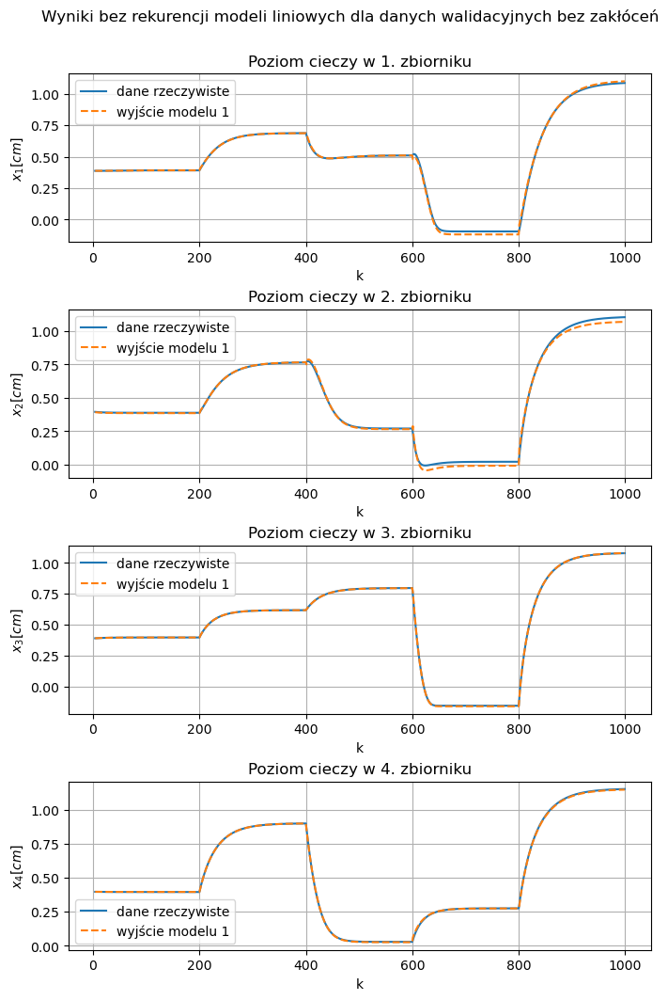

In [ ]:
y_pred_dict = {"x1": x1_pred_val, "x2": x2_pred_val, "x3": x3_pred_val, "x4": x4_pred_val}
plot_model_result_all_tanks(df_val, dataset_name, "walidacyjnych", pred_mode, y_pred_dict)

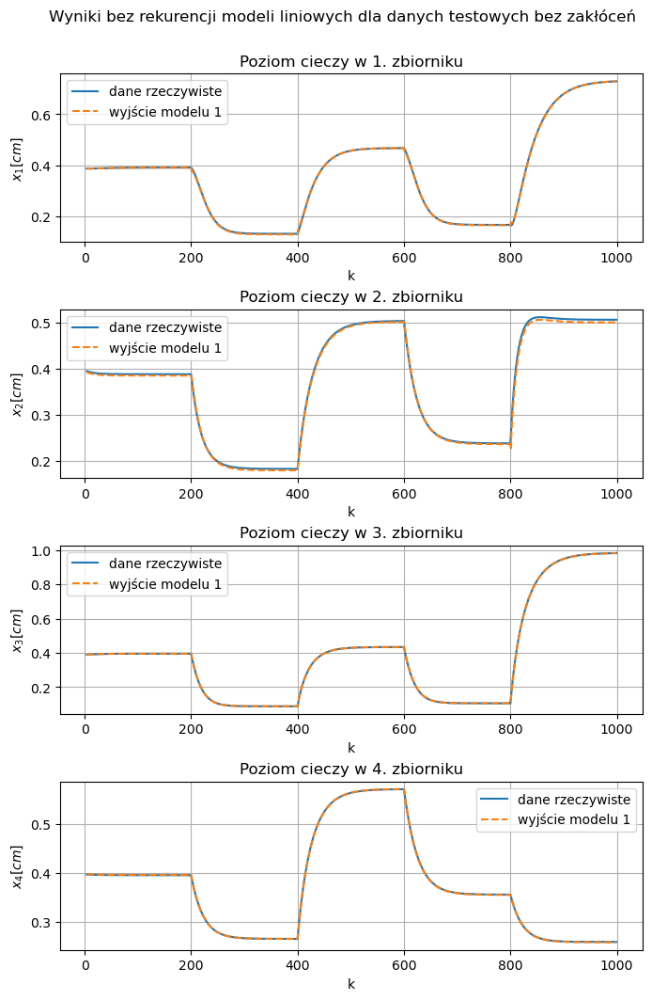

In [ ]:
y_pred_dict = {"x1": x1_pred_test, "x2": x2_pred_test, "x3": x3_pred_test, "x4": x4_pred_test}
plot_model_result_all_tanks(df_test, dataset_name, "testowych", pred_mode, y_pred_dict)

In [ ]:
pred_mode = "z rekurencją"

In [ ]:
# x1
logged_model = 'runs:/6d4684620fc544f6b6f1b1479b60c6c2/ELM'
# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)
loaded_model_unwrap = loaded_model.unwrap_python_model().model
x1_pred_train = loaded_model.predict(pd.DataFrame(df_train[loaded_model_unwrap.feature_names_in_]))
x1_pred_test = loaded_model.predict(pd.DataFrame(df_test[loaded_model_unwrap.feature_names_in_]))
x1_pred_val = loaded_model.predict(pd.DataFrame(df_val[loaded_model_unwrap.feature_names_in_]))

# x2
logged_model = 'runs:/7b58363458f34d7f86604b788d27582c/ELM'
# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)
loaded_model_unwrap = loaded_model.unwrap_python_model().model
x2_pred_train = loaded_model.predict(pd.DataFrame(df_train[loaded_model_unwrap.feature_names_in_]))
x2_pred_test = loaded_model.predict(pd.DataFrame(df_test[loaded_model_unwrap.feature_names_in_]))
x2_pred_val = loaded_model.predict(pd.DataFrame(df_val[loaded_model_unwrap.feature_names_in_]))

# x3
logged_model = 'runs:/02f8e67e11094272a3625e4afddd2859/ELM'
# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)
loaded_model_unwrap = loaded_model.unwrap_python_model().model
x3_pred_train = loaded_model.predict(pd.DataFrame(df_train[loaded_model_unwrap.feature_names_in_]))
x3_pred_test = loaded_model.predict(pd.DataFrame(df_test[loaded_model_unwrap.feature_names_in_]))
x3_pred_val = loaded_model.predict(pd.DataFrame(df_val[loaded_model_unwrap.feature_names_in_]))

# x4
logged_model = 'runs:/e7f1f243d39543b19e7f49499e06c83b/ELM'
# Load model as a PyFuncModel.
loaded_model = mlflow.pyfunc.load_model(logged_model)
loaded_model_unwrap = loaded_model.unwrap_python_model().model
x4_pred_train = loaded_model.predict(pd.DataFrame(df_train[loaded_model_unwrap.feature_names_in_]))
x4_pred_test = loaded_model.predict(pd.DataFrame(df_test[loaded_model_unwrap.feature_names_in_]))
x4_pred_val = loaded_model.predict(pd.DataFrame(df_val[loaded_model_unwrap.feature_names_in_]))

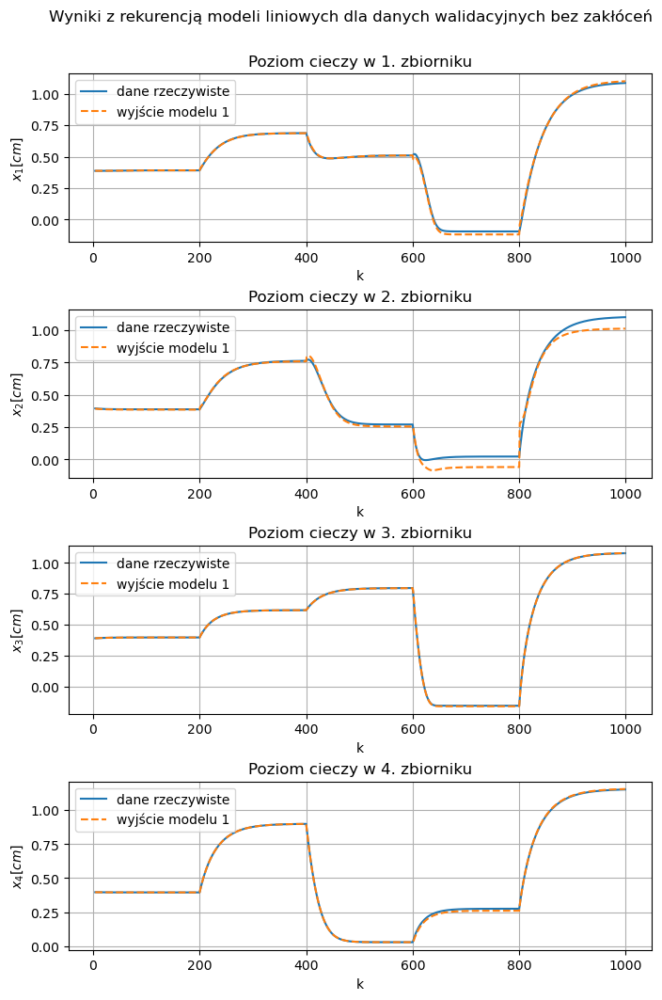

In [ ]:
y_pred_dict = {"x1": x1_pred_val, "x2": x2_pred_val, "x3": x3_pred_val, "x4": x4_pred_val}
plot_model_result_all_tanks(df_val, dataset_name, "walidacyjnych", pred_mode, y_pred_dict)

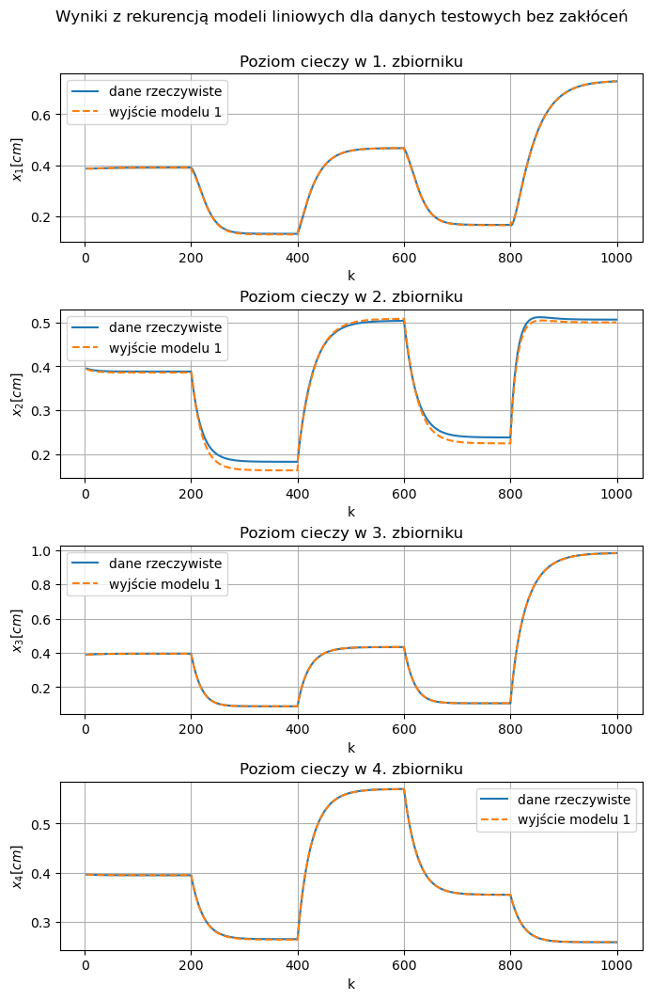

In [ ]:
y_pred_dict = {"x1": x1_pred_test, "x2": x2_pred_test, "x3": x3_pred_test, "x4": x4_pred_test}
plot_model_result_all_tanks(df_test, dataset_name, "testowych", pred_mode, y_pred_dict)

In [ ]:
def plot_model_error(df, y_name):
    plt.grid()
    e_list = [col for col in df.columns if (y_name in col) & ('e_x' in col)]
    colors = ['tab:orange', 'tab:green', 'tab:purple', 'tab:red', 'tab:cyan', 'tab:gray']
    color_i=0
    line_styles = ['--', '-.', (0, (5, 5)), (0, (3, 5, 1, 5)), ':']
    for i, e in enumerate(e_list):
        plt.plot(df[e], label=f'błąd modelu {i+1}', c=colors[i%len(colors)], linestyle=line_styles[i % len(line_styles)])
    plt.xlabel('k')
    plt.ylabel(f'$e_{{x{y_name[1]}}}$')
    plt.title(f"Błędy modeli dla {y_name[1]}. zbiornika")
    plt.legend()

In [ ]:
def plot_model_error_without_h1(df, y_name):
    plt.grid()
    e_list = [col for col in df.columns if (y_name in col) & ('e_x' in col)]
    colors = ['tab:orange', 'tab:green', 'tab:purple', 'tab:red', 'tab:cyan', 'tab:gray']
    line_styles = ['--', '-.', (0, (5, 5)), (0, (3, 5, 1, 5)), ':']
    for i, e in enumerate(e_list):
        i += 1
        plt.plot(df[e], label=f'błąd modelu {i+1}', c=colors[i%len(colors)], linestyle=line_styles[i % len(line_styles)])
    plt.xlabel('k')
    plt.ylabel(f'$e_{{x{y_name[1]}}}$')
    plt.title(f"Błędy modeli dla {y_name[1]}. zbiornika")
    plt.legend()

In [ ]:
def plot_model_error_all_tanks(df, dataset_name, data_name, pred_mode):
    num_plots = 4
    if pred_mode=='z rekurencją':
        num_plots=5
    fig=plt.figure(figsize=(8,11.5))
    plt.subplot(num_plots, 1, 1)
    plot_model_error(df, 'x1')
    plt.subplot(num_plots, 1, 2)
    plot_model_error(df, 'x2')
    plt.subplot(num_plots, 1, 3)
    plot_model_error(df, 'x3')
    if pred_mode=='z rekurencją':
        plt.subplot(num_plots, 1, 4)
        df_to_plot = df.drop(columns=['e_x3_statespace_1'])
        plot_model_error_without_h1(df_to_plot, 'x3')
    plt.subplot(num_plots, 1, num_plots)
    plot_model_error(df, 'x4')

    plt.subplots_adjust(hspace=0.4*num_plots/4)
    fig.subplots_adjust(top=0.92)
    fig.suptitle(f"Błędy modeli liniowych dla danych {data_name} {dataset_name} w trybie {pred_mode}")

    plt.savefig(f"../img/error_ol_{model_class}_{data_name}_{dataset_name}_v3_{pred_mode}.png", bbox_inches='tight')

    plt.show()

In [ ]:
# plot_model_error_all_tanks(df_val, dataset_name, "walidacyjnych", pred_mode)

In [ ]:
# plot_model_error_all_tanks(df_test, dataset_name, "testowych", pred_mode)